<a id="top3"></a>
# Exploratory Data Analysis (EDA) and dimensionality reduction

This part will focus on the Exploratory Data Analysis (EDA) of the extracted features and also will apply dimensionality reduction techniques.

- [1. Exploratory Data Analysis](#3a)
    * [Reviewing the Crema-D dataset](#3a1)
- [2. Dimensionality reduction techniques with PCA and T-SNE](#3b)
- [3. Summary](#3c)

In [1]:
# import libraries
import pandas as pd
import numpy as np
import random
import os
import librosa
import librosa.display
import IPython.display as ipd
from IPython.core.display import display
import noisereduce as nr
from scipy.io import wavfile
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
%config InlineBackend.figure_format='retina'
import warnings
warnings.filterwarnings("ignore")

#### Import dataframe with features

First, let's import the dataset previously exported:

In [2]:
# Import the dataset and verify that the upload is successful
df = pd.read_csv('emotions_data_features.csv')
print('The dataset has {} audio files'.format(df.shape[0]))
df.sample()

The dataset has 16783 audio files


,path,filename,dataset,duration,gender,age,emotion,f0_mean,f0_median,f0_std,...,mfcc21_var,mfcc22_var,mfcc23_var,mfcc24_var,mfcc25_var,mfcc26_var,mfcc27_var,mfcc28_var,mfcc29_var,mfcc30_var
1564,../Audio files/CREMA-D/1020_IOM_HAP_XX.wav,1020_IOM_HAP_XX,CREMA-D,2.269,female,61,happy,222.842523,207.052985,47.734535,...,59.770054,37.68126,46.88179,43.488266,37.70166,182.44005,198.59886,154.4291,154.92941,257.6134


### <a id='3a'>1. Exploratory Data Analysis</a>

As a first step, I want to check if there are **missing values** in the DataFrame:

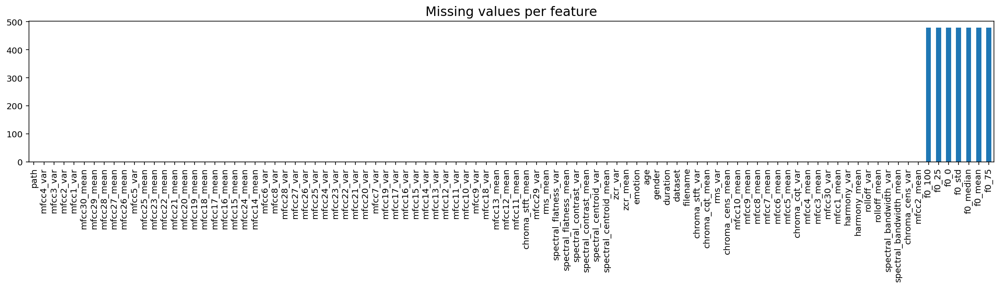

In [3]:
# Displaying the number of missing values for each feature
df.isna().sum().sort_values().plot(kind="bar", figsize=(20, 3))
plt.title("Missing values per feature", size=15)
plt.show()

It appears that some fundamental frequencies where not retrieved during the extraction operation. Let's find how spread are these missing values among the dataset sources:

In [4]:
df_na = df.f0_mean.isnull().groupby([df['dataset']]).sum().astype(int).reset_index(name='missing values')
df_na.set_index('dataset').transpose()

dataset,CREMA-D,EmoV_DB,JL-Corpus,RAVDESS,SAVEE,TESS
missing values,479,0,0,0,0,0


Interestingly, **all the missing frequencies data come from the same source, the CREMA-D dataset**.

For the moment, I will continue with the data exploration by obtaining informative plots of the numerical features with simple plots:

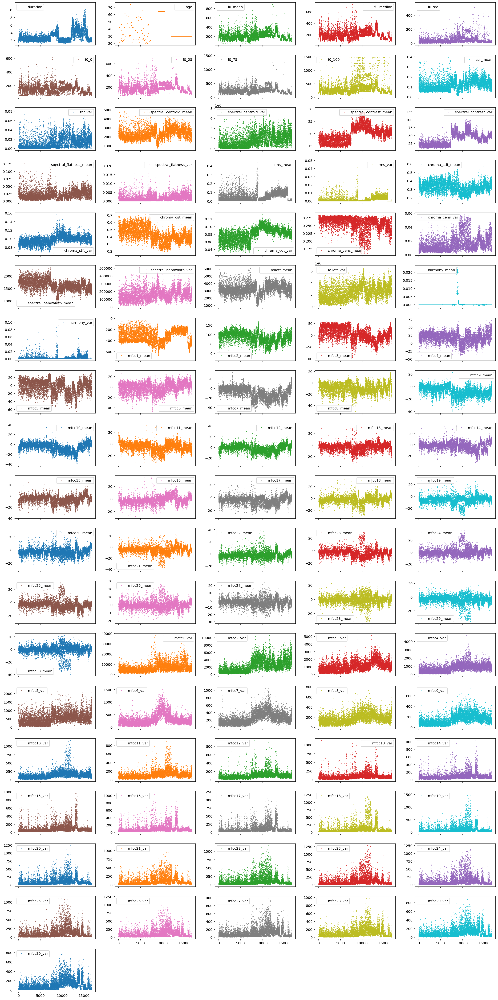

In [5]:
# Informative plots on numerical data:
df.plot(lw=0, marker=".", subplots=True, layout=(-1, 5), figsize=(20, 40), markersize=1);
plt.tight_layout()

I note that **there seems to be a difference in the overall quality of the data from each source**, as if the type of recording produced a different set of characteristics. The audio samples were certainly recorded and processed with different equipment and techniques (e.g., using different compression), and despite the cleaning operation, these inequalities end up emerging.

Let's investigate the difference better by enlarging a graph of a feature and highlighting the sources:

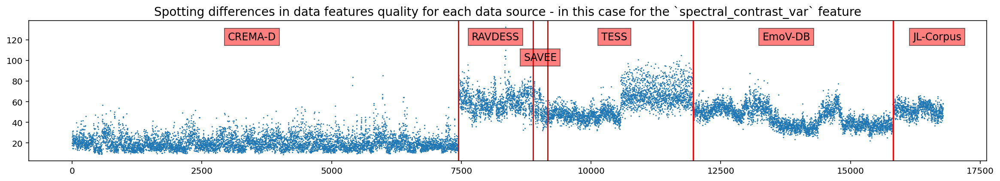

In [6]:
# Spotting differences in data features quality by dataset:
df['spectral_contrast_var'].plot(lw=0, marker=".", figsize=(20, 3), markersize=1)
plt.axvline(x = 7442, color = 'r')
plt.text(3000, 120, 'CREMA-D', fontsize=12, bbox=dict(facecolor='red', alpha=0.5))
plt.axvline(x = 8882, color = 'r')
plt.text(7700, 120, 'RAVDESS', fontsize=12, bbox=dict(facecolor='red', alpha=0.5))
plt.axvline(x = 9162, color = 'r')
plt.text(8700, 100, 'SAVEE', fontsize=12, bbox=dict(facecolor='red', alpha=0.5))
plt.axvline(x = 11964, color = 'r')
plt.text(10200, 120, 'TESS', fontsize=12, bbox=dict(facecolor='red', alpha=0.5))
plt.axvline(x = 15824, color = 'r')
plt.text(13300, 120, 'EmoV-DB', fontsize=12, bbox=dict(facecolor='red', alpha=0.5))
plt.text(16200, 120, 'JL-Corpus', fontsize=12, bbox=dict(facecolor='red', alpha=0.5))
plt.title('Spotting differences in data features quality for each data source - in this case for the `spectral_contrast_var` feature', size=14)
plt.show()

From this graph I can assume that:
- there are certainly differences among the quality of the features extracted from each data source, possibly due to the mismatch of the audio recordings and processing like audio compression
- there are also internal differences, but these seem to be more related to the type of speaker or the emotion conveyed. For example, in `TESS` data, the first part is about the audio of an elderly woman, while the second part is about a young woman
- overall **CREMA-D** data seems to be more "far-off" than the other sources in multiple numerical plots like in the one above, hence will need more investigation

### Data transformation

Let's check the data again, but with histograms to see the distribution:

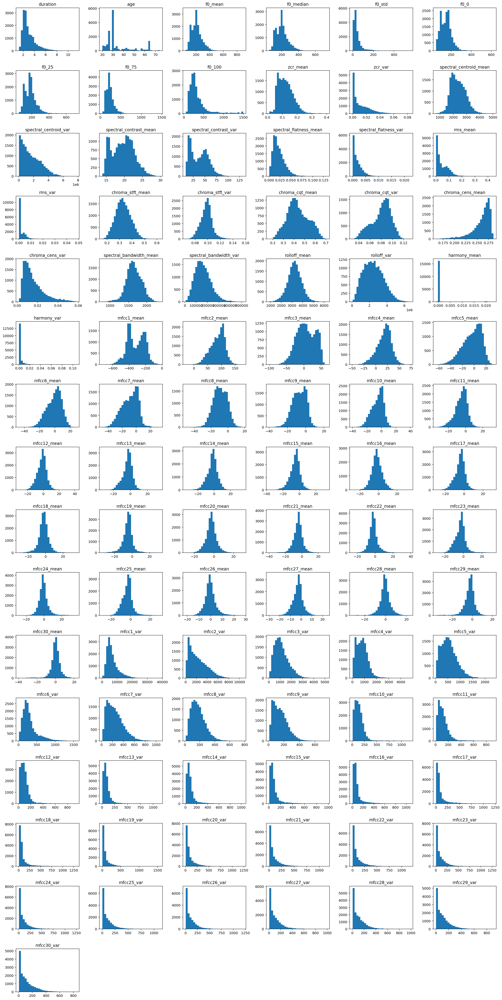

In [7]:
df.hist(layout=(-1, 6), bins=30, grid=False, figsize=(20, 40))
plt.tight_layout()

As some features are right skewed, I apply a **logarithmic transformation** except to those with many zero values:

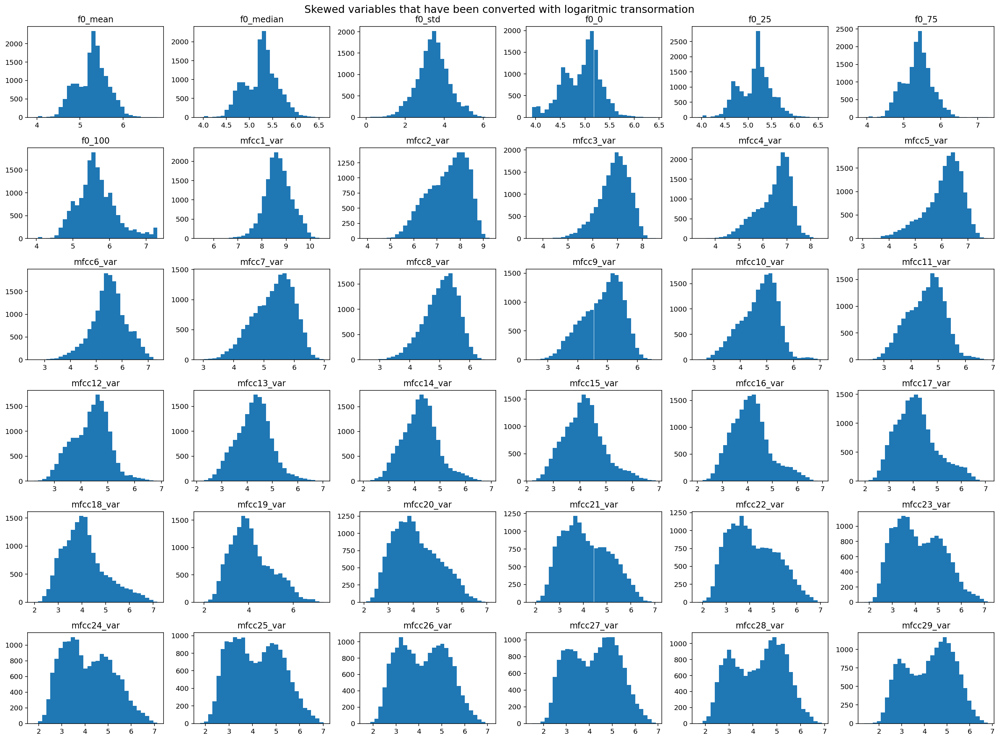

In [8]:
to_encode = ['f0_mean','f0_median','f0_std','f0_0','f0_25','f0_75','f0_100','mfcc1_var','mfcc2_var','mfcc3_var','mfcc4_var','mfcc5_var',
             'mfcc6_var', 'mfcc7_var','mfcc8_var','mfcc9_var','mfcc10_var','mfcc11_var','mfcc12_var','mfcc13_var','mfcc14_var','mfcc15_var',
             'mfcc16_var','mfcc17_var','mfcc18_var','mfcc19_var','mfcc20_var','mfcc21_var','mfcc22_var','mfcc23_var','mfcc24_var','mfcc25_var',
             'mfcc26_var', 'mfcc27_var','mfcc28_var','mfcc29_var']

# Apply log-transformation to selected continous features
df[to_encode] = np.log1p(df[to_encode])

# Plot distribution of these continuous variables after the transformation
df[to_encode].hist(layout=(-1, 6), bins=30, grid=False, figsize=(20, 15));
plt.suptitle('Skewed variables that have been converted with logaritmic transormation', size=15)
plt.tight_layout()
plt.show()

Now that the features looks more normally distributed, I can explore the data in relationship with the target. However, first I want to investigate more about the Crema-D dataset.

## <a id='3a1'>Reviewing the CREMA-D dataset</a>

As the **CREMA-D** dataset has revealed some problems in the extraction of fundamental frequencies and has showed overall dissimilarities in the preliminary analysis, I decided to revise its [documentation](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4313618/). I found that this dataset is somewhat different from the others, for example:
- It has a video component for each sample and is particularly suited to the study of multimodal emotion expression and perception, thus not exclusively for sound but for both auditory and visual stimuli
- Its data is crowd-sourced with a large number of actors and evaluators, and labels are assigned on average after a maximum of 10 ratings
- Emotion is also rated by its intensity: low, medium, high or unclassified (most samples are unclassified)
- The predicted human emotion recognition score for the audio-only data is only 40.9%

For these reasons **I will analyze the data together and without this source**, creating a new DataFrame called `df_wo_cremad`. In the first part I will explore the features with the target not using CREMA-D data, then compare both DataFrames by using visualizations of dimensionality reduction techniques.

In [9]:
# Creating a new DataFrame without the CREMA-D data
df_wo_cremad = df[(df.dataset != 'CREMA-D')]

# Check new data
print("Number of rows of the new DataFrame without the CREMA-D data: " + str(df_wo_cremad.shape[0]))

Number of rows of the new DataFrame without the CREMA-D data: 9342


Let's focus on the main features of the new DataFrame, the one with the remaining five datasets:

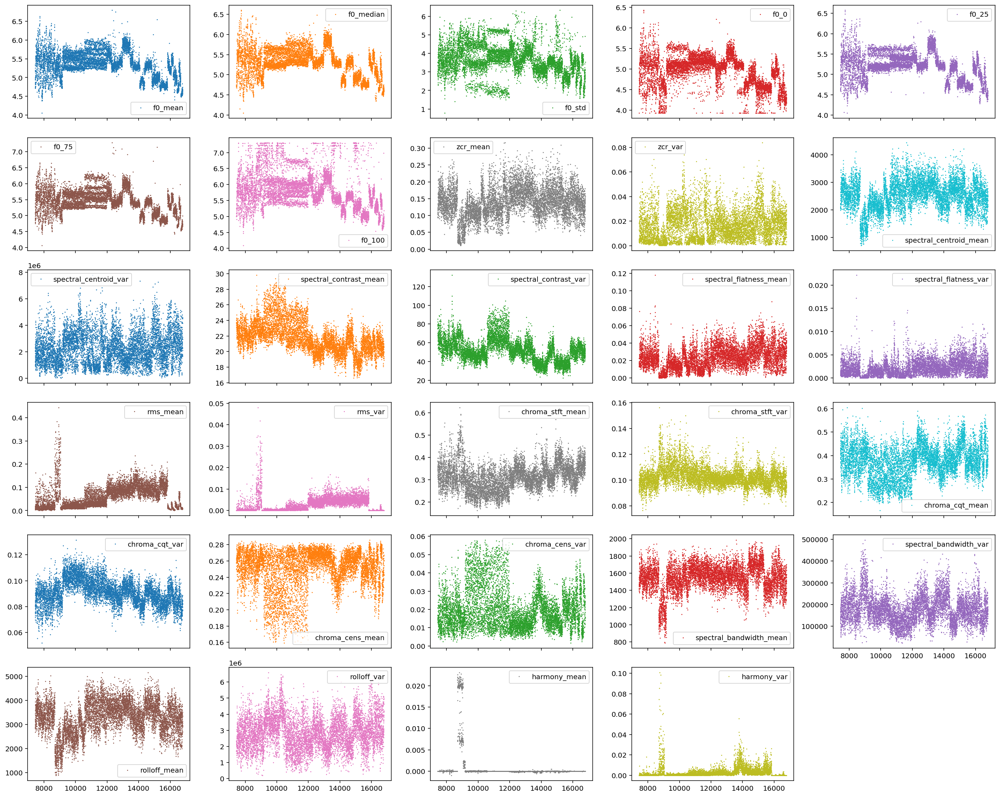

In [10]:
features = ['f0_mean', 'f0_median', 'f0_std', 'f0_0', 'f0_25', 'f0_75', 'f0_100', 'zcr_mean', 'zcr_var', 'spectral_centroid_mean', 'spectral_centroid_var', 
            'spectral_contrast_mean', 'spectral_contrast_var', 'spectral_flatness_mean', 'spectral_flatness_var', 'rms_mean', 'rms_var', 'chroma_stft_mean',
            'chroma_stft_var', 'chroma_cqt_mean', 'chroma_cqt_var', 'chroma_cens_mean', 'chroma_cens_var', 'spectral_bandwidth_mean',
            'spectral_bandwidth_var', 'rolloff_mean', 'rolloff_var', 'harmony_mean', 'harmony_var']

# Informative plots on numerical data:
df_wo_cremad[features].plot(lw=0, marker=".", subplots=True, layout=(-1,5), figsize=(20, 16), markersize=1);
plt.tight_layout()

### Addressing outliers

Again, some differences between data taken from different datasets are evident, particularly in some features such as `rms` and `harmony`, where some values have a peak. Looking at their location, they also seem to be from the **SAVEE** dataset. However, this time I will leave this dataset and proceed only to manually remove some outliers.

In [11]:
# Manually removing outlier rows
df_wo_cremad = df_wo_cremad[df.f0_mean > 4.1]
df_wo_cremad = df_wo_cremad[df.f0_mean < 6.5]
df_wo_cremad = df_wo_cremad[df.f0_median > 4.25]
df_wo_cremad = df_wo_cremad[df.f0_75 < 6.7]
df_wo_cremad = df_wo_cremad[df.spectral_flatness_mean < 0.075]
df_wo_cremad = df_wo_cremad[df.spectral_flatness_var < 0.013]
df_wo_cremad = df_wo_cremad[df.spectral_contrast_var < 110]
df_wo_cremad = df_wo_cremad[df.rms_mean < 0.3]
df_wo_cremad = df_wo_cremad[df.harmony_var < 0.04]

print('The dataset has {} audio files after the outlier removal'.format(df_wo_cremad.shape[0]))

The dataset has 9291 audio files after the outlier removal


About 50 samples has been removed. It is worth plot again the data so see the effect of this operation:

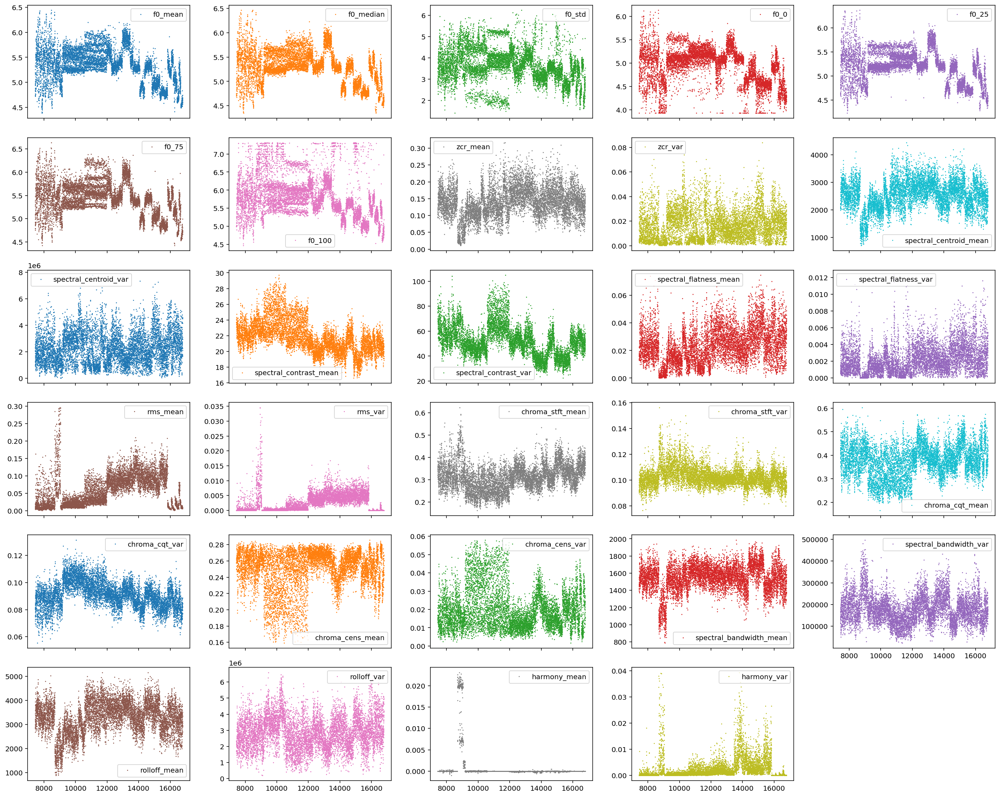

In [12]:
# Informative plots on numerical data:
df_wo_cremad[features].plot(lw=0, marker=".", subplots=True, layout=(-1,5), figsize=(20, 16), markersize=1);
plt.tight_layout()

### In-depth EDA

Let's begin by having a look to the mean fundamental fequency distribution for each emotion:

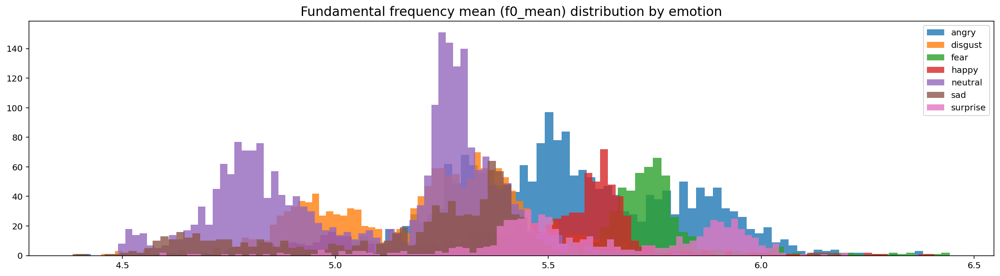

In [13]:
# Check fundamental fequency distribution for each emotion
df_wo_cremad.groupby("emotion").f0_mean.hist(figsize=(20, 5), grid=False, bins=100, alpha=0.8)
plt.legend(df.emotion.unique())
plt.title('Fundamental frequency mean (f0_mean) distribution by emotion', size=15)
plt.show()

Some emotion appears to have a difference in relation with the fundamental frequency mean. For instance, `surprise` and `sad` frequencies occupies quite distinct areas. Also, a binomial distribution is noticeable in each target, which can be related to the gender of the speaker. To confirm this let's have a look on the relationship with male and female voices with frequency:

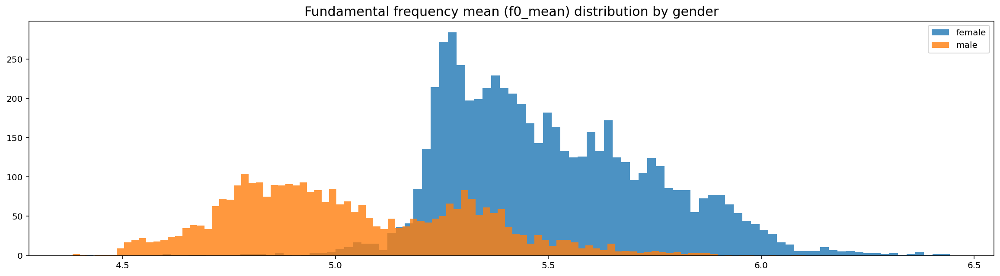

In [14]:
# Fundamental frequency mean, distribution by gender
df_wo_cremad.groupby('gender').f0_mean.hist(figsize=(20, 5), grid=False, bins=100, alpha=0.8)
plt.legend(['female','male'])
plt.title('Fundamental frequency mean (f0_mean) distribution by gender', size=15)
plt.show()

As expected, female and male voices occupy different frequency areas, with the former on average higher than the latter.

Let's now use boxplots to check the features in relationship with the target:

In [15]:
# Defining a function to plot features in relationship with the target
def plot_features(feat1, feat2, title):
    fig, axes = plt.subplots(nrows = 1, ncols = 2, figsize = (20, 5), sharey=False)

    sns.boxplot(x=df.emotion,y=feat1, ax=axes[0])
    sns.stripplot(x=df.emotion,y=feat1, size=3, color=".3", alpha=.05, ax=axes[0])

    sns.boxplot(x=df.emotion,y=feat2, ax=axes[1])
    sns.stripplot(x=df.emotion,y=feat2, size=3, color=".3", alpha=.05, ax=axes[1])

    fig.suptitle(title, fontsize=16, fontweight="bold")
    fig.tight_layout()
    plt.show()

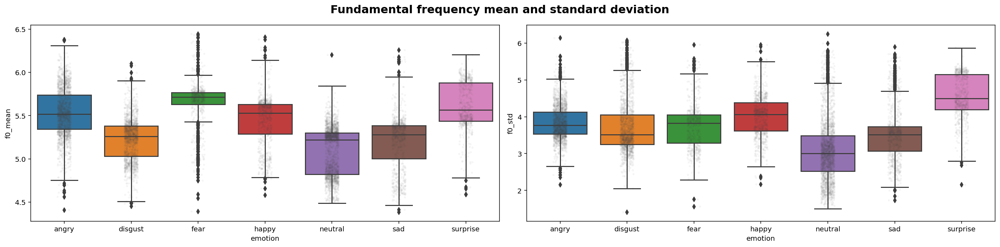

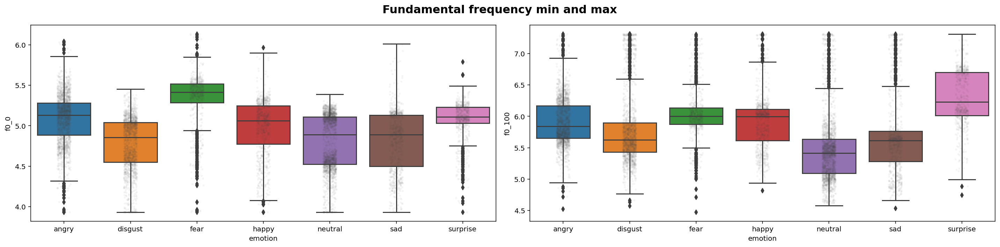

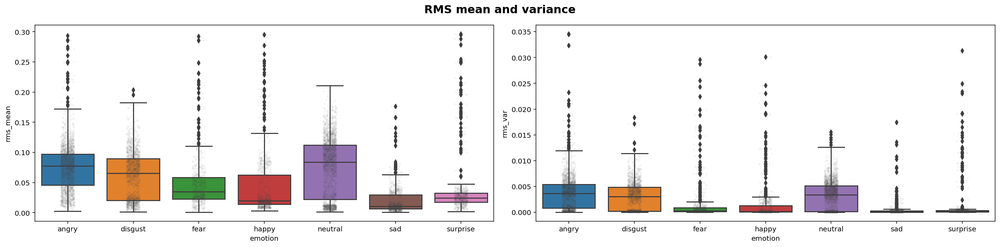

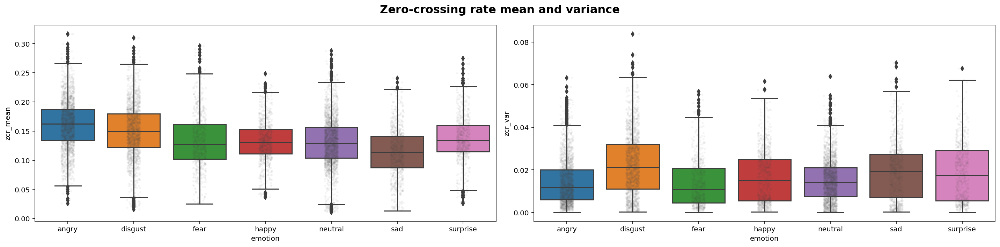

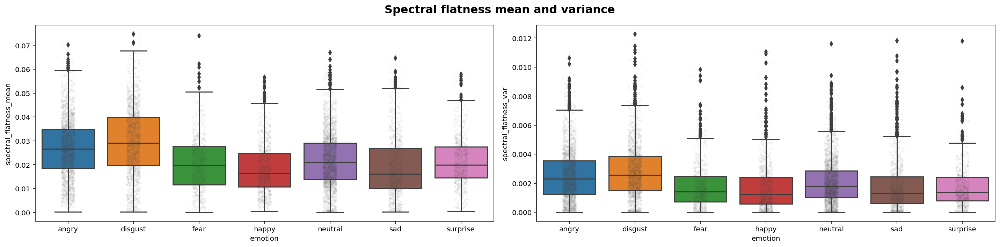

...

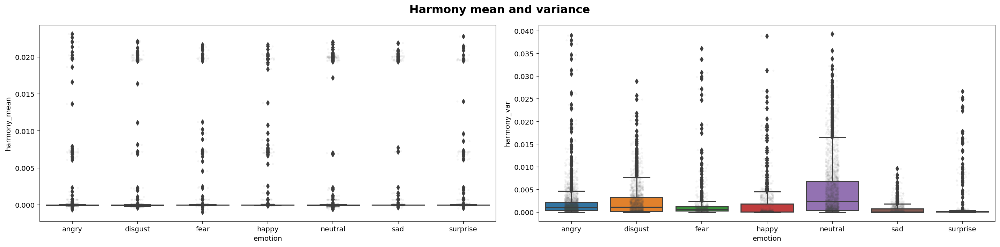

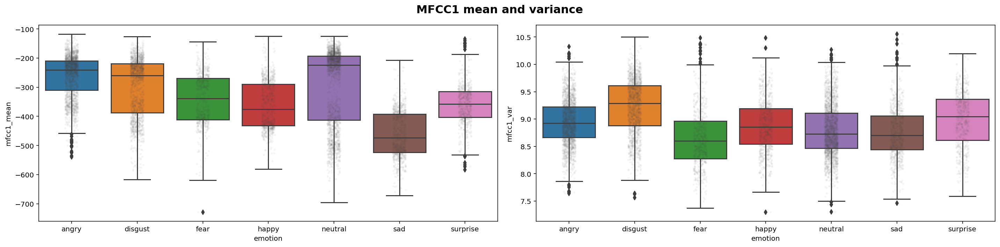

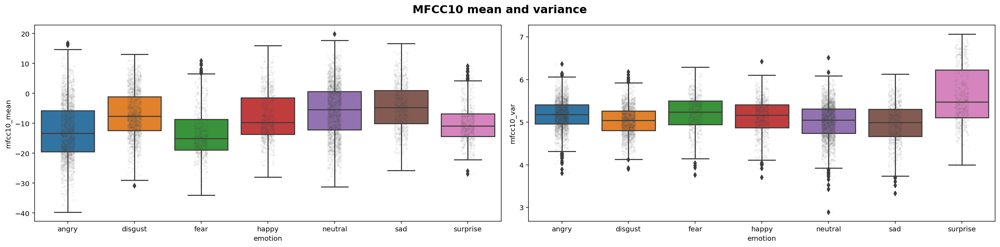

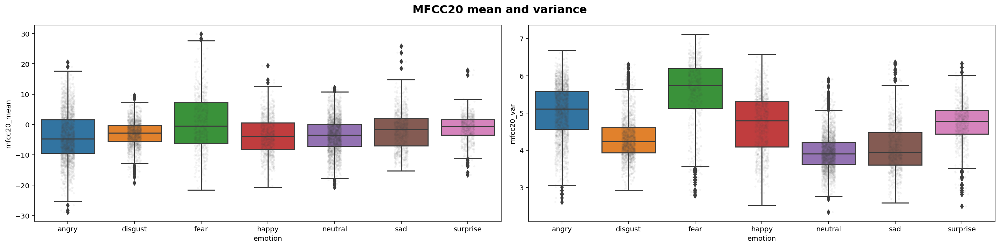

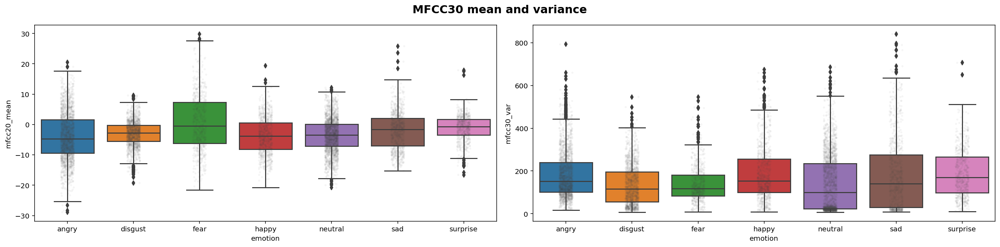

In [16]:
# Plot the features mean and variances, also with a few plots of MFCCs data
plot_features(df_wo_cremad.f0_mean, df_wo_cremad.f0_std, "Fundamental frequency mean and standard deviation")
plot_features(df_wo_cremad.f0_0, df_wo_cremad.f0_100, "Fundamental frequency min and max")
plot_features(df_wo_cremad.rms_mean, df_wo_cremad.rms_var, "RMS mean and variance")
plot_features(df_wo_cremad.zcr_mean, df_wo_cremad.zcr_var, "Zero-crossing rate mean and variance")
plot_features(df_wo_cremad.spectral_flatness_mean, df_wo_cremad.spectral_flatness_var, "Spectral flatness mean and variance")
plot_features(df_wo_cremad.spectral_centroid_mean, df_wo_cremad.spectral_centroid_var, "Spectral centroid mean and variance")
plot_features(df_wo_cremad.spectral_contrast_mean, df_wo_cremad.spectral_contrast_var, "Spectral contrast mean and variance")
plot_features(df_wo_cremad.spectral_bandwidth_mean, df_wo_cremad.spectral_bandwidth_var, "Spectral bandwidth mean and variance")
plot_features(df_wo_cremad.rolloff_mean, df_wo_cremad.rolloff_var, "Rolloff mean and variance")
plot_features(df_wo_cremad.chroma_stft_mean, df_wo_cremad.chroma_stft_var, "Chroma stft mean and variance")
plot_features(df_wo_cremad.chroma_cqt_mean, df_wo_cremad.chroma_cqt_var, "Chroma cqt mean and variance")
plot_features(df_wo_cremad.chroma_cens_mean, df_wo_cremad.chroma_cens_var, "Chroma cens mean and variance")
plot_features(df_wo_cremad.harmony_mean, df_wo_cremad.harmony_var, "Harmony mean and variance")
plot_features(df_wo_cremad.mfcc1_mean, df_wo_cremad.mfcc1_var, "MFCC1 mean and variance")
plot_features(df_wo_cremad.mfcc10_mean, df_wo_cremad.mfcc10_var, "MFCC10 mean and variance")
plot_features(df_wo_cremad.mfcc20_mean, df_wo_cremad.mfcc20_var, "MFCC20 mean and variance")
plot_features(df_wo_cremad.mfcc20_mean, df_wo_cremad.mfcc30_var, "MFCC30 mean and variance")

Several observations can be made from these boxplots, for instance:
- `neutral` and `sad` fundamental frequencies are the lowest, `angry`, `fear` and `suprise` the highest
- `suprise` has greater frequency standard deviation than all other emotions, while `neutral` has the lowest standard deviation
- **RMS** values tends to highlight that `angry` and `neutral` samples are on average 'louder' than `sad` or `suprise`
- **MFCCs** values do appear to actually show some differences between categories
- In general, **lots of samples share similar attribute values**, making it difficult to only rely on few features to find a clear distinction with the target

### <a id='3b'>2. Dimensionality reduction</a>

To further explore data with visualizations let's apply a few dimensionality reduction techniques like PCA and T-SNE and plot their principal components, this time also comparing the results **with and without the CREMA-D** dataset.

### PCA

Data preparation:

In [17]:
# Creating a new DataFrame with the CREMA-D data and the other cleaned DataFrame
df_cremad = df[(df.dataset == 'CREMA-D')]
df_cremad = df_cremad.dropna(axis=0)
df_all = pd.concat([df_cremad, df_wo_cremad], axis=0)

# Check new data
print("Number of rows of the new DataFrame with the CREMA-D data and the other cleaned datasets: " + str(df_all.shape[0]))

Number of rows of the new DataFrame with the CREMA-D data and the other cleaned datasets: 16253


In [18]:
# Convert target data to numerical values
df_all['emotion'].replace({'angry':0,'disgust':1,'fear':2,'happy':3,'neutral':4,'sad':5,'surprise':6}, inplace=True)

# Sorting data for better visualization (legend colors are picked by target order)
df_all = df_all.sort_values(by=['emotion']) 

# Create feature matrix (X) and numerical target (y)
X = df_all.drop(columns=['path','filename','dataset','duration','gender','emotion'])
y = df_all.emotion.values

# Same process as above for the other DataFrame withtout Crema-D
df_wo_cremad['emotion'].replace({'angry':0,'disgust':1,'fear':2,'happy':3,'neutral':4,'sad':5,'surprise':6}, inplace=True)
df_wo_cremad = df_wo_cremad.sort_values(by=['emotion'])
X_wo_cremad = df_wo_cremad.drop(columns=['path','filename','dataset','duration','gender','emotion'])
y_wo_cremad = df_wo_cremad.emotion.values

Let's begin by scaling the data with `StandardScaled` tool:

In [19]:
# Scale the data
from sklearn.preprocessing import StandardScaler

# Create Standard scaler
scaler = StandardScaler()

# Rescale data of both dataframes
X_rescaled = scaler.fit_transform(X)
X_wo_cremad_rescaled = scaler.fit_transform(X_wo_cremad)

Plot scree-plots and the number of components for each 10%  step of the variance:

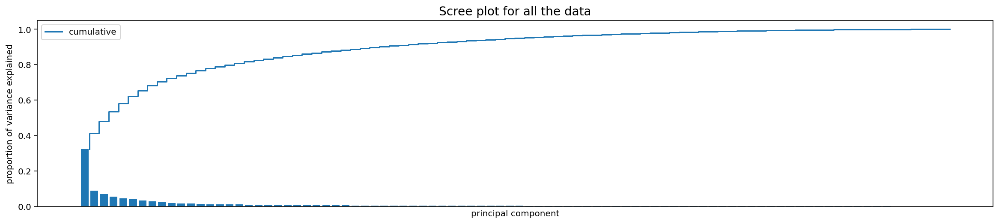

10% variance : components  0
20% variance : components  0
30% variance : components  0
40% variance : components  1
50% variance : components  3
60% variance : components  5
70% variance : components  8
80% variance : components  16
90% variance : components  31
100% variance : components  89


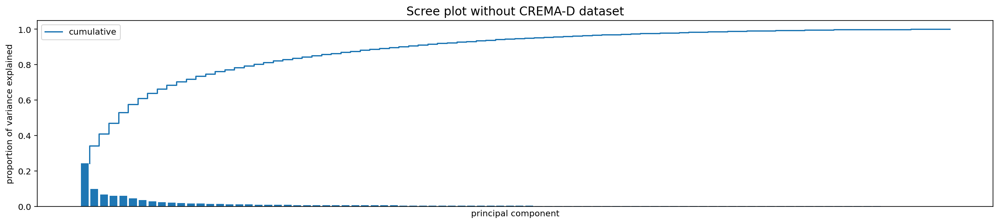

10% variance : components  0
20% variance : components  0
30% variance : components  1
40% variance : components  2
50% variance : components  4
60% variance : components  6
70% variance : components  10
80% variance : components  18
90% variance : components  33


In [20]:
# Import PCA library
from sklearn.decomposition import PCA

# Create PCA transformer - all the components will be extracted
pca = PCA()

# Function for scree-plot graph and data
def plot_scree_plot(data_rescaled, title):
    # Apply PCA to rescaled data
    pca.fit(data_rescaled, y=None)

    # Proportion of variance explained
    pve = pca.explained_variance_ratio_

    # Create bar plot
    xcor = np.arange(1, len(pve) + 1)  # 1,2,..,n_components
    plt.figure(figsize=(20,4))
    plt.bar(xcor, pve)
    plt.xticks(xcor)

    # Add cumulative sum
    pve_cumsum = np.cumsum(pve)
    plt.step(xcor + 0.5, pve_cumsum, label="cumulative")

    # Add labels
    plt.title(title, size=14)
    plt.xlabel("principal component")
    plt.ylabel("proportion of variance explained")
    plt.xticks([])
    plt.legend()
    plt.show()
    
    # Number of components for each 10%  step of the variance
    for percentage in range(1,11):
        total = 0
        count = []
        for i in pve:
            total = total + i
            count.append(total)
            if total > percentage/10:
                print('{}% variance'.format(percentage*10), ': components ', len(count)-1)
                break;

# Calling function
plot_scree_plot(X_rescaled, 'Scree plot for all the data')
plot_scree_plot(X_wo_cremad_rescaled, 'Scree plot without CREMA-D dataset')

The scree-plots do not show significant differences among the two DataFrames, this also because all the components were extracted.

Now let's create a PCA transformer with 4 dimensions and plot the results in a 2D dimensional space:

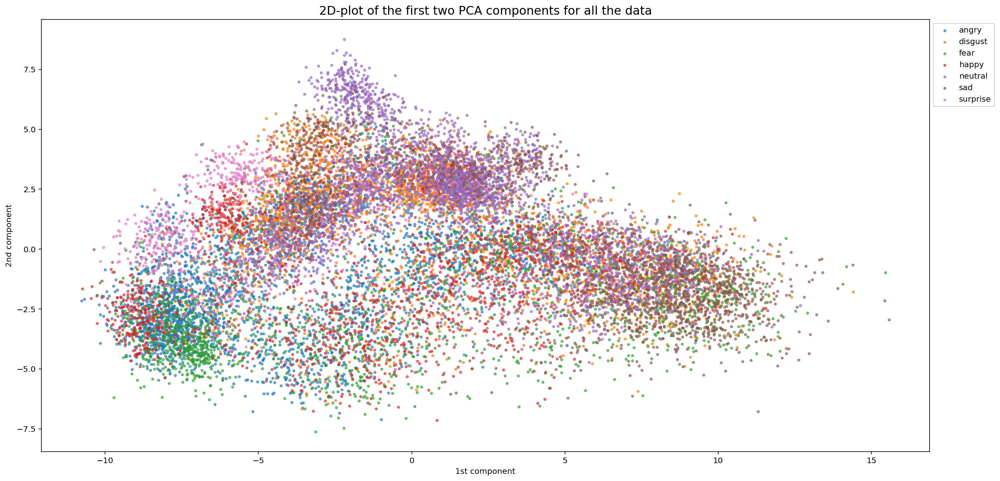

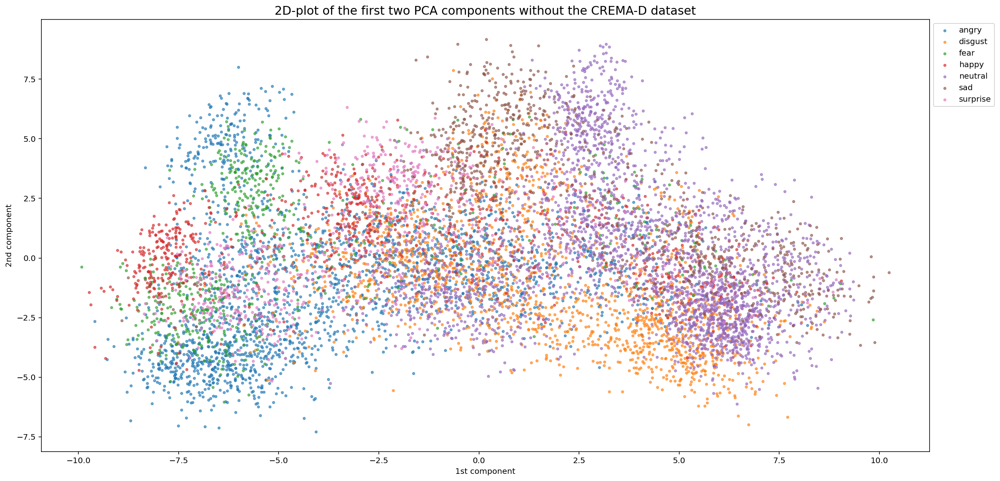

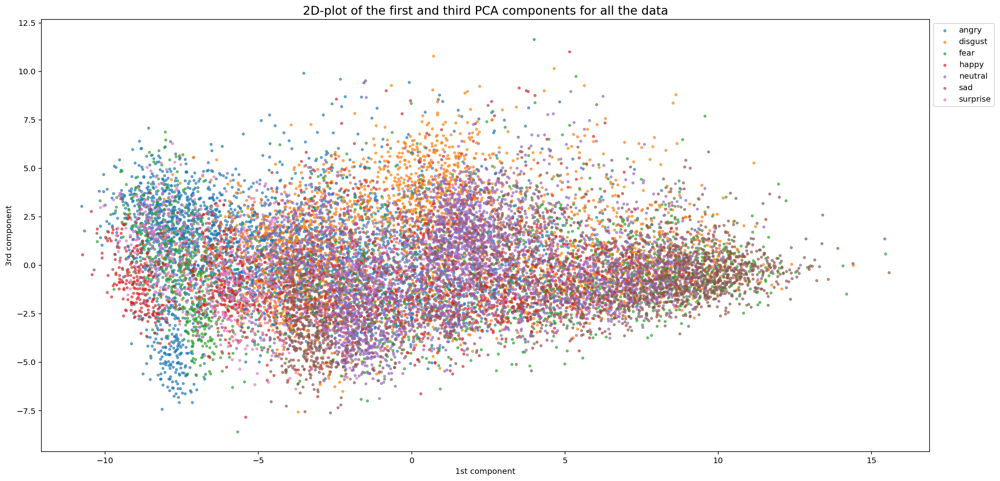

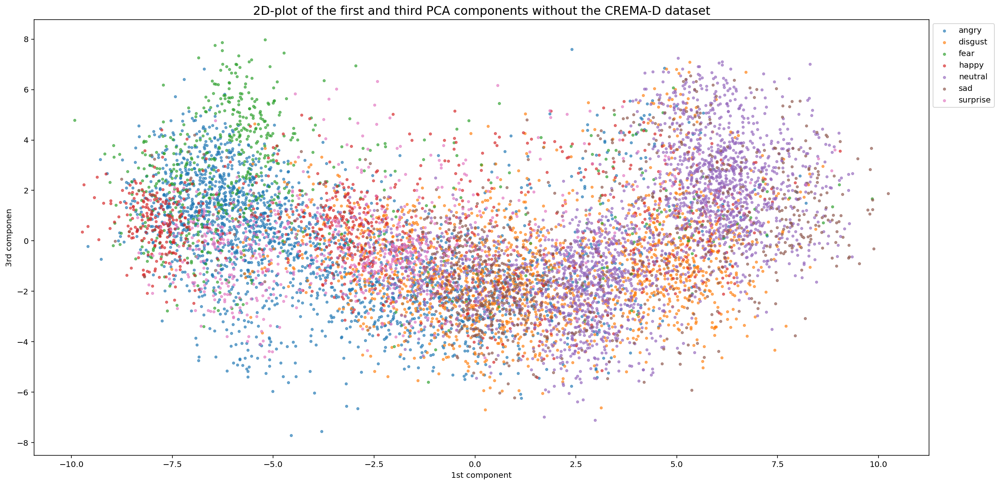

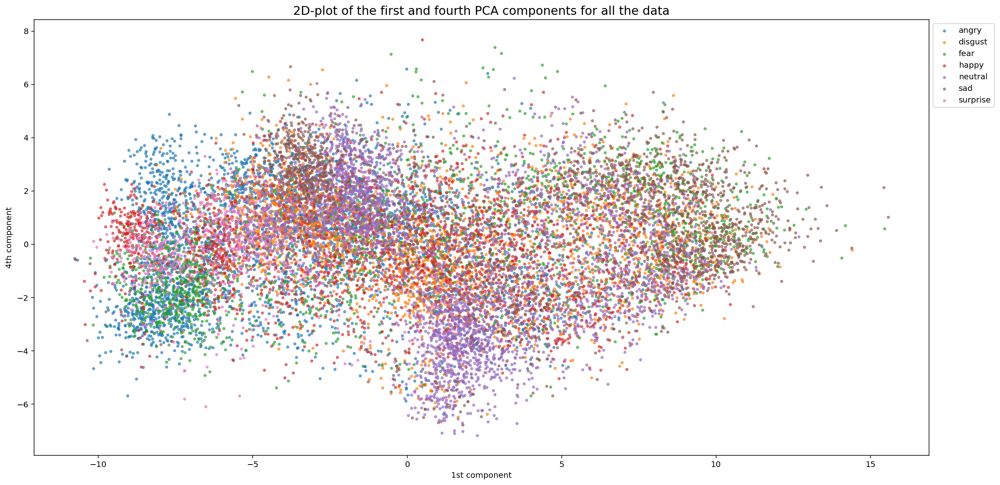

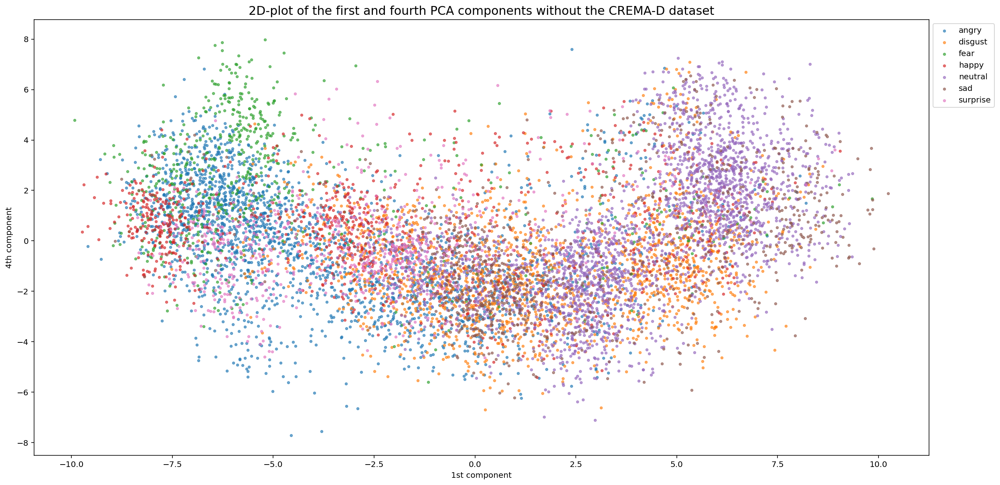

In [21]:
# Create PCA transformer for 4 dimension
pca4 = PCA(n_components=4)

# Apply PCA to rescaled data
x_4d_rescaled = pca4.fit_transform(X_rescaled)
x_4d_rescaled_no_crema = pca4.fit_transform(X_wo_cremad_rescaled)

# Plot category
target_names = ['angry','disgust','fear','happy','neutral','sad','surprise']

# Function to plot different PCA components
def plot_pca(rescaled_data, target, component1, component2, component1_name, component2_name, title):
    plt.figure(figsize=(20,10))

    for kind in [0, 1, 2, 3, 4, 5, 6]:
        # Category samples filter by idx
        idx = target == kind

        # Plot their components
        plt.scatter(rescaled_data[idx, component1], rescaled_data[idx, component2], label="{}".format(target_names[kind]), s=8, alpha=0.6)

    # Labels and legend
    plt.legend(loc='upper left', bbox_to_anchor=(1, 1))
    plt.title(title, size=15)
    plt.xlabel(component1_name)
    plt.ylabel(component2_name)
    plt.show()

# Apply function to first 4 components of each pair of data
plot_pca(x_4d_rescaled, y, 0,1,'1st component','2nd component', '2D-plot of the first two PCA components for all the data')
plot_pca(x_4d_rescaled_no_crema, y_wo_cremad, 0,1,'1st component','2nd component', '2D-plot of the first two PCA components without the CREMA-D dataset')

plot_pca(x_4d_rescaled, y, 0,2,'1st component','3rd component', '2D-plot of the first and third PCA components for all the data')
plot_pca(x_4d_rescaled_no_crema, y_wo_cremad, 0,2,'1st component','3rd componen', '2D-plot of the first and third PCA components without the CREMA-D dataset')

plot_pca(x_4d_rescaled, y, 0,3,'1st component','4th component', '2D-plot of the first and fourth PCA components for all the data')
plot_pca(x_4d_rescaled_no_crema, y_wo_cremad, 0,2,'1st component','4th component', '2D-plot of the first and fourth PCA components without the CREMA-D dataset')

In the **PCA** graphs, there is a clear improvement in the visualization of the samples with and without the Crema-D dataset, although there are still several common areas where the samples overlap.

### T-SNE

Let's see the data again, but this time applying T-SNE dimensionality reduction.

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 16253 samples in 0.001s...
[t-SNE] Computed neighbors for 16253 samples in 5.860s...
[t-SNE] Computed conditional probabilities for sample 1000 / 16253
[t-SNE] Computed conditional probabilities for sample 2000 / 16253
[t-SNE] Computed conditional probabilities for sample 3000 / 16253
[t-SNE] Computed conditional probabilities for sample 4000 / 16253
[t-SNE] Computed conditional probabilities for sample 5000 / 16253
[t-SNE] Computed conditional probabilities for sample 6000 / 16253
[t-SNE] Computed conditional probabilities for sample 7000 / 16253
[t-SNE] Computed conditional probabilities for sample 8000 / 16253
[t-SNE] Computed conditional probabilities for sample 9000 / 16253
[t-SNE] Computed conditional probabilities for sample 10000 / 16253
[t-SNE] Computed conditional probabilities for sample 11000 / 16253
[t-SNE] Computed conditional probabilities for sample 12000 / 16253
[t-SNE] Computed conditional probabilities for sam

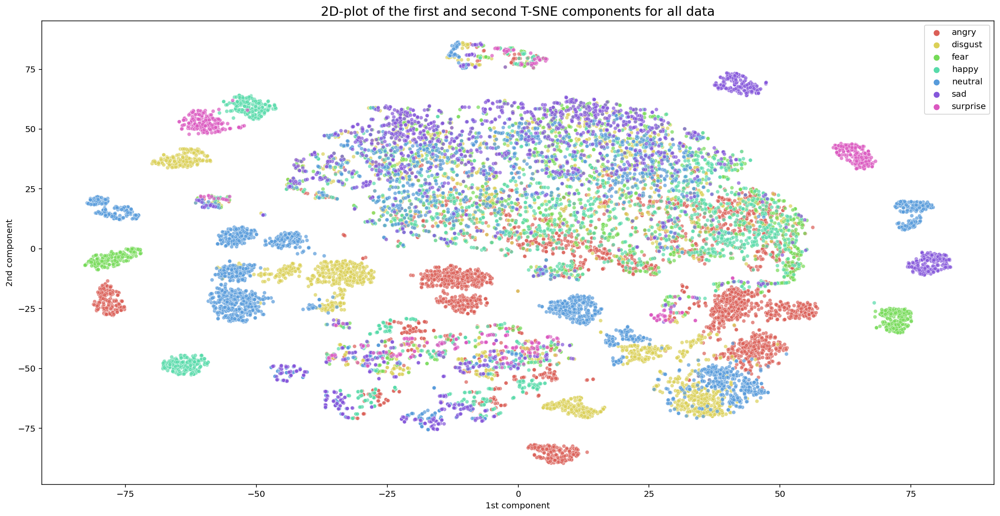

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 9291 samples in 0.001s...
[t-SNE] Computed neighbors for 9291 samples in 2.789s...
[t-SNE] Computed conditional probabilities for sample 1000 / 9291
[t-SNE] Computed conditional probabilities for sample 2000 / 9291
[t-SNE] Computed conditional probabilities for sample 3000 / 9291
[t-SNE] Computed conditional probabilities for sample 4000 / 9291
[t-SNE] Computed conditional probabilities for sample 5000 / 9291
[t-SNE] Computed conditional probabilities for sample 6000 / 9291
[t-SNE] Computed conditional probabilities for sample 7000 / 9291
[t-SNE] Computed conditional probabilities for sample 8000 / 9291
[t-SNE] Computed conditional probabilities for sample 9000 / 9291
[t-SNE] Computed conditional probabilities for sample 9291 / 9291
[t-SNE] Mean sigma: 2.190265
[t-SNE] KL divergence after 250 iterations with early exaggeration: 71.600227
[t-SNE] KL divergence after 1000 iterations: 1.288404


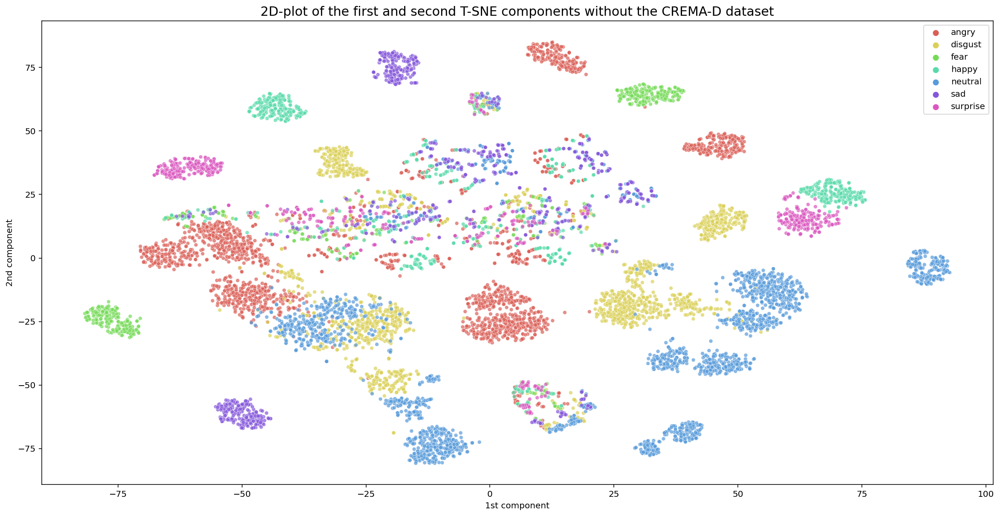

In [22]:
# Docoumentation at: https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html?highlight=tsne#sklearn.manifold.TSNE
# Import TSNE
from sklearn.manifold import TSNE

# Create TSNE tranformer
tsne = TSNE(n_components=2, verbose=1, random_state=0)

# Define a function to apply and plot T-SNE:
def plot_tsne(rescaled_data, target, title):
    # Apply T-SNE transformer on rescaled data
    tsne_2 = tsne.fit_transform(rescaled_data)
    
    # Create a legend for pre-converted target data
    legend = {0:'angry',1:'disgust',2:'fear',3:'happy',4:'neutral',5:'sad',6:'surprise'}
    y = [legend[x] for x in target]

    # Store T-SNE data in a DataFrame
    tsne2 = pd.DataFrame()
    tsne2['y'] = y
    tsne2['1st component'] = tsne_2[:,0]
    tsne2['2nd component'] = tsne_2[:,1]
    
    # Plot data
    plt.figure(figsize=(20,10))
    sns.scatterplot(x='1st component', y='2nd component', hue=tsne2.y.tolist(),
                palette=sns.color_palette('hls', 7),
                data=tsne2, s=20, alpha=0.7)
    plt.title(title, size=15)
    plt.show()
    
# Apply function
plot_tsne(X_rescaled, y, '2D-plot of the first and second T-SNE components for all data')
plot_tsne(X_wo_cremad_rescaled, y_wo_cremad, '2D-plot of the first and second T-SNE components without the CREMA-D dataset')

The difference is much more noticeable in the **T-SNE** plot, as only a small fraction of the total samples is clustered together, while most of the sample categories occupy a defined space.

The **CREMA-D** dataset is certainly an excellent resource for the audiovisual study of emotion perception. It offers an interesting approach to the topic and presents curious results from its primary research at the University of Pennsylvania.

However, it has some problems when applied to a machine learning model for only sounds, as it mostly creates confusion rather than helping to generalize the characteristics of emotion. Therefore, because of the above points, as well as the difficulty of retrieving features from its `.wav` files, **I decide not to use this dataset for the modelling part of this project**.

### <a id='3c'>EDA summary</a>

- Revisited the Crema-D documentation due to problems in the feature extraction process, found differences in the concept of the dataset, and made the decision to remove it from the modeling part after the dimensionality reduction plots
- Applyed a logarithmic transformation to right-skewed features
- Removed outliers from the remaining data
- Analysis of the features in relation to the objectives
- Identification of good target separation with PCA and T-SNE visualization

In [23]:
# write csv
df_wo_cremad.to_csv('emotions_data_transformed.csv', index=False)

<br>[Back to top](#top3)